# Импортируемые модули

In [142]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler, MaxAbsScaler, Normalizer
from sklearn.decomposition import PCA

# Загрузка и проверка данных


In [143]:
file_path = 'data.csv'

df = pd.read_csv(file_path)

df.head()

,id,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,...,f_19,f_20,f_21,f_22,f_23,f_24,f_25,f_26,f_27,f_28
0,0,-0.389420,-0.912791,0.648951,0.589045,-0.830817,0.733624,2.258560,2,13,...,-0.478412,-0.757002,-0.763635,-1.090369,1.142641,-0.884274,1.137896,1.309073,1.463002,0.813527
1,1,-0.689249,-0.453954,0.654175,0.995248,-1.653020,0.863810,-0.090651,2,3,...,-0.428791,-0.089908,-1.784204,-0.839474,0.459685,1.759412,-0.275422,-0.852168,0.562457,-2.680541
2,2,0.809079,0.324568,-1.170602,-0.624491,0.105448,0.783948,1.988301,5,11,...,-0.413534,-1.602377,1.190984,3.267116,-0.088322,-2.168635,-0.974989,1.335763,-1.110655,-3.630723
3,3,-0.500923,0.229049,0.264109,0.231520,0.415012,-1.221269,0.138850,6,2,...,0.619283,1.287801,0.532837,1.036631,-2.041828,1.440490,-1.900191,-0.630771,-0.050641,0.238333
4,4,-0.671268,-1.039533,-0.270155,-1.830264,-0.290108,-1.852809,0.781898,8,7,...,-1.628830,-0.434948,0.322505,0.284326,-2.438365,1.473930,-1.044684,1.602686,-0.405263,-1.987263


# Предварительная обработка данных

In [144]:
df = df.drop('id', axis = 1) 

df.info()

df.isnull().sum()

df = df.dropna()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 98000 entries, 0 to 97999
Data columns (total 29 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   f_00    98000 non-null  float64
 1   f_01    98000 non-null  float64
 2   f_02    98000 non-null  float64
 3   f_03    98000 non-null  float64
 4   f_04    98000 non-null  float64
 5   f_05    98000 non-null  float64
 6   f_06    98000 non-null  float64
 7   f_07    98000 non-null  int64  
 8   f_08    98000 non-null  int64  
 9   f_09    98000 non-null  int64  
 10  f_10    98000 non-null  int64  
 11  f_11    98000 non-null  int64  
 12  f_12    98000 non-null  int64  
 13  f_13    98000 non-null  int64  
 14  f_14    98000 non-null  float64
 15  f_15    98000 non-null  float64
 16  f_16    98000 non-null  float64
 17  f_17    98000 non-null  float64
 18  f_18    98000 non-null  float64
 19  f_19    98000 non-null  float64
 20  f_20    98000 non-null  float64
 21  f_21    98000 non-null  float64
 22

# Визуализация отношения между переменными в наборе данных

In [145]:
sns.pairplot(df, kind='scatter', diag_kind='kde')
plt.show()

# Удаление выбросов из набора данных 

In [146]:
def remove_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

for column in df:
    df = remove_outliers(df, column)

df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 73445 entries, 0 to 97999
Data columns (total 29 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   f_00    73445 non-null  float64
 1   f_01    73445 non-null  float64
 2   f_02    73445 non-null  float64
 3   f_03    73445 non-null  float64
 4   f_04    73445 non-null  float64
 5   f_05    73445 non-null  float64
 6   f_06    73445 non-null  float64
 7   f_07    73445 non-null  int64  
 8   f_08    73445 non-null  int64  
 9   f_09    73445 non-null  int64  
 10  f_10    73445 non-null  int64  
 11  f_11    73445 non-null  int64  
 12  f_12    73445 non-null  int64  
 13  f_13    73445 non-null  int64  
 14  f_14    73445 non-null  float64
 15  f_15    73445 non-null  float64
 16  f_16    73445 non-null  float64
 17  f_17    73445 non-null  float64
 18  f_18    73445 non-null  float64
 19  f_19    73445 non-null  float64
 20  f_20    73445 non-null  float64
 21  f_21    73445 non-null  float64
 22  f_2

# Кластеризация данных с использованием алгоритма KMeans и визуализация результатов для выбора оптимального количества кластеров с помощью метода локтя

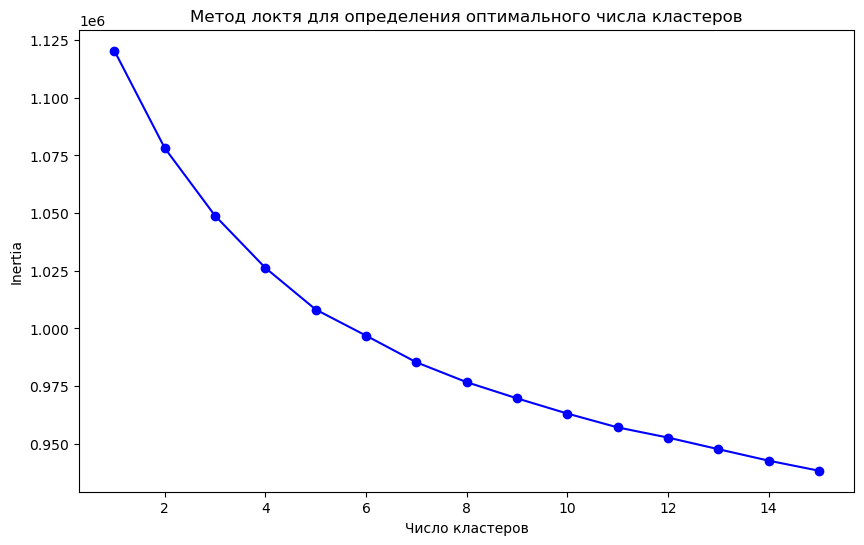

In [147]:
scaler = RobustScaler()
scaled_data = scaler.fit_transform(df)

inertia = []
K = range(1, 16)
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(scaled_data)
    inertia.append(kmeans.inertia_)

plt.figure(figsize=(10, 6))
plt.plot(K, inertia, 'bo-')
plt.xlabel('Число кластеров')
plt.ylabel('Inertia')
plt.title('Метод локтя для определения оптимального числа кластеров')
plt.show()

# Кластеризация данных с использованием алгоритма KMeans

In [148]:
kmeans = KMeans(n_clusters=5, random_state=42)
clusters = kmeans.fit_predict(scaled_data)


# Сокращение размерности данных с использованием метода главных компонент (PCA) и добавление результатов кластеризации в качестве меток

In [149]:
pca = PCA(n_components=2)
principal_components = pca.fit_transform(scaled_data)
pca_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])
pca_df['Cluster'] = clusters

# Визуализацию кластеров

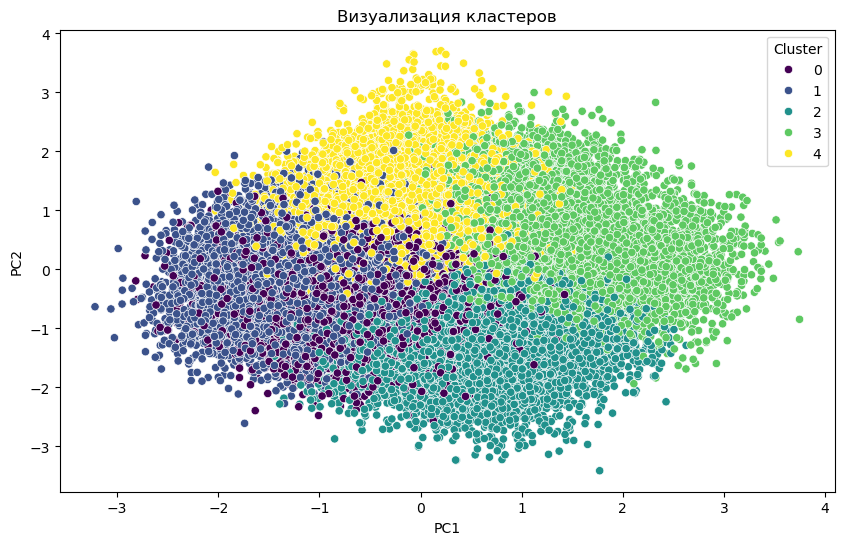

In [150]:
plt.figure(figsize=(10, 6))
sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='Cluster', palette='viridis')
plt.title('Визуализация кластеров')
plt.show()

# K-Means кластеризация
K-Means кластеризация — это широко используемый алгоритм машинного обучения без учительского обучения, предназначенный для разделения данных на 
K различных непересекающихся групп или кластеров.<br> 
Основная цель — организовать точки данных так, чтобы они были более похожи друг на друга в рамках одного кластера, чем с точками в других кластерах.

Алгоритм представляет собой версию EM-алгоритма, применяемого также для разделения смеси гауссиан. Он разбивает множество элементов векторного пространства на заранее известное число кластеров k.

Основная идея заключается в том, что на каждой итерации перевычисляется центр масс для каждого кластера, полученного на предыдущем шаге, затем векторы разбиваются на кластеры вновь в соответствии с тем, какой из новых центров оказался ближе по выбранной метрике.

Алгоритм завершается, когда на какой-то итерации не происходит изменения внутрикластерного расстояния. Это происходит за конечное число итераций, так как количество возможных разбиений конечного множества конечно, а на каждом шаге суммарное квадратичное отклонение V уменьшается, поэтому зацикливание невозможно.

## Главная идея
__Центроиды__ — Каждый кластер имеет центральную точку, называемую центроидом. Центроид представляет собой среднее значение всех точек в данном кластере.

__Инерция__ — Измеряется как сумма квадратов расстояний точек до своих соответствующих центроидов (WCSS). Основная задача K-Means — минимизировать эту инерцию.

$$ \text{Инерция} = \sum_{i=1}^{k} \sum_{x \in C_i} \| x - \mu_i \|^2 $$

где:
- $k$ — количество кластеров,
- $C_i$ — множество точек данных в кластере $i$,
- $x$ — точка данных,
- $\mu_i$ — центроид кластера $i$.

## Алгоритм

1. __Инициализация__ — Выбираются K начальных центроидов случайным образом из набора точек данных.

2. __Присвоение__ — Каждая точка данных назначается ближайшему центроиду, образуя таким образом K кластеров.

$$ C_i = \{ x : \| x - \mu_i \|^2 \leq \| x - \mu_j \|^2 \, \forall j, 1 \leq j \leq K \} $$

3. __Обновление__ — Центроиды пересчитываются как среднее значение всех точек в каждом кластере.

$$ \mu_i = \frac{1}{|C_i|} \sum_{x \in C_i} x $$

4. __Повторение__ — Шаги присвоения и обновления повторяются до тех пор, пока центроиды не перестанут значительно изменяться или не будет достигнуто максимальное количество итераций.

## Выбор количества кластеров
### Метод локтя
В кластерном анализе метод локтя — это эвристика, используемая для определения количества кластеров в наборе данных . Метод состоит из построения графика объясненной вариации как функции количества кластеров и выбора локтя кривой в качестве количества кластеров для использования. Суть — Построение графика инерции в зависимости от количества кластеров, для определения "точки локтя".

## Использование
K-Means прост в реализации и обладает высокой вычислительной эффективностью для больших объемов данных. Однако алгоритм требует предварительного определения количества кластеров и может прийти к локальному минимуму, поэтому рекомендуется запускать его несколько раз с различными инициализациями.
